# Capstone Project: Detección de anomalias en un tren de laminación

# 1. Definición del problema

> Identificar que partes del proceso están desviandose de la normalidad y cuales son las causas de estas desviaciones.

## Carga de paquetes y datos

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import pickle
import matplotlib
import plotly.graph_objects as go
from scipy.stats import zscore
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn import svm

In [2]:
data = pickle.load(open('data/datos_capstone_project.pickle',
                        'rb'))

# 2. Análisis exploratorio de los datos

## 2.1 Obtención de secciones y sus atributos 

In [3]:
data.keys()

dict_keys(['general', 'S1', 'S2', 'S3', 'S4', 'S5', 'S6a', 'S6b', 'S6c', 'S7a', 'S7b', 'S7c'])

In [4]:
seccions = ['S1', 'S2', 'S3', 'S4', 'S5', 'S6a', 'S6b', 'S6c', 'S7a', 'S7b', 'S7c']

In [5]:
for key in data.keys():
    print('{}:'.format(key))
    print(list(data[key].columns))

general:
['weight', 'id_colada', 'lenght', 'material', 'id_barra', 'calidad', 'diametro', 'timestamp_millis', 'tipo_fallo', 'timestamp_barra', 'patron_enfriamiento', 'id_rollo', 'linea']
S1:
['presion1', 'temperatura10', 'temperatura5', 'temperatura4', 'presion_aire', 'presion_oxigeno', 'temperatura9', 'temperatura8', 'temperatura3', 'temperatura2', 'temperatura1', 'temperatura7', 'temperatura6', 'temperatura_salida', 'temperatura_aire']
S2:
['velocidad4', 'corriente4', 'velocidad1', 'corriente1', 'velocidad2', 'corriente2', 'velocidad3', 'corriente3', 'temperatura']
S3:
['temperatura1', 'temperatura2', 'voltaje1', 'potencia1', 'voltaje2', 'potencia2', 'voltaje3', 'potencia3', 'voltaje4', 'potencia4']
S4:
['velocidad1', 'corriente1', 'velocidad2', 'corriente2', 'velocidad3', 'corriente3', 'velocidad4', 'corriente4', 'velocidad5', 'corriente5', 'velocidad6', 'corriente6', 'velocidad7', 'corriente7', 'temperatura']
S5:
['velocidad4', 'presion4', 'corriente4', 'caudal4_sup', 'caudal4_inf'

Obtenemos la longitud del DataFrame para cada sección. Seguidamente contamos cuantas variables contienen datos, así tenemos una idea de la cantidad de NaN existentes para cada variable.

In [6]:
for key in data.keys():
    print('Longitud del DF {}: {}'.format(key, len(data[key])))

Longitud del DF general: 4478
Longitud del DF S1: 4478
Longitud del DF S2: 4478
Longitud del DF S3: 4478
Longitud del DF S4: 4478
Longitud del DF S5: 4478
Longitud del DF S6a: 4478
Longitud del DF S6b: 4478
Longitud del DF S6c: 4478
Longitud del DF S7a: 4478
Longitud del DF S7b: 4478
Longitud del DF S7c: 4478


In [7]:
for key in data.keys():
    print('Longitud del DF {}: {}'.format(key, data[key].count()))

Longitud del DF general: weight                 4478
id_colada              4478
lenght                 4478
material               4478
id_barra               4478
calidad                4478
diametro               4478
timestamp_millis          1
tipo_fallo             4478
timestamp_barra        4478
patron_enfriamiento    4478
id_rollo               4478
linea                  4478
dtype: int64
Longitud del DF S1: presion1              4206
temperatura10         4206
temperatura5          4206
temperatura4          4205
presion_aire          4206
presion_oxigeno       4206
temperatura9          4206
temperatura8          4206
temperatura3          4205
temperatura2          4185
temperatura1          4185
temperatura7          4206
temperatura6          4206
temperatura_salida    4478
temperatura_aire      4206
dtype: int64
Longitud del DF S2: velocidad4     4157
corriente4     4157
velocidad1     4085
corriente1     4085
velocidad2     4012
corriente2     4012
velocidad3     4143


Como se puede observar seguidamente algunas de las secciones tienen más atributos que otras, de hecho las secciones **'S7a', 'S7b' y 'S7c'** tienen 3 o menos atributos.

In [8]:
data['general'].head()

,weight,id_colada,lenght,material,id_barra,calidad,diametro,timestamp_millis,tipo_fallo,timestamp_barra,patron_enfriamiento,id_rollo,linea
0,2652.0,GS134970,17679.0,WAK7508055N000,200109_1457370,K75G,5.5,NaN,-1,2020-01-09 17:41:36,5531425,44,2
1,2635.0,GS134970,17661.0,WAK7508055N000,200109_1502590,K75G,5.5,NaN,-1,2020-01-09 17:42:12,5531425,45,1
2,2646.0,GS134970,17714.0,WAK7508055N000,200109_1504000,K75G,5.5,NaN,-1,2020-01-09 17:44:21,5531425,46,2
3,2643.0,GS134970,17740.0,WAK7508055N000,200109_1505010,K75G,5.5,NaN,-1,2020-01-09 17:45:03,5531425,47,1
4,2649.0,GS134970,17608.0,WAK7508055N000,200109_1506010,K75G,5.5,NaN,-1,2020-01-09 17:47:02,5531425,48,2


In [9]:
data['S1'].head()

,presion1,temperatura10,temperatura5,temperatura4,presion_aire,presion_oxigeno,temperatura9,temperatura8,temperatura3,temperatura2,temperatura1,temperatura7,temperatura6,temperatura_salida,temperatura_aire
0,0.798836,1088.252285,1154.081309,1170.828534,851.008454,2.612372,1155.221715,1143.133764,1141.480962,949.455933,922.140609,1156.069242,1115.250757,1006.434201,393.984376
1,0.797551,1088.717833,1154.834393,1172.430785,850.932829,2.602393,1155.383580,1143.470022,1141.370769,951.141810,921.580726,1156.443279,1115.408000,991.006244,393.810601
2,0.797677,1088.982066,1155.502487,1174.043164,850.463124,2.596084,1155.285475,1143.366285,1141.259041,952.700130,921.248252,1156.554518,1115.608573,989.610673,393.669586
3,0.798795,1089.293727,1156.185011,1175.528468,849.968448,2.591308,1155.051799,1143.086065,1141.136264,954.292863,920.968056,1156.550603,1116.119950,993.099617,393.526507
4,0.800776,1089.636981,1157.024341,1177.610712,849.501714,2.589190,1154.990671,1142.253202,1141.013233,956.195738,921.178377,1156.362519,1116.841141,1001.768170,393.361487


In [10]:
data['S7a']

,orden_formador_lazo,corriente,altura_bucle
0,0.967320,77.993070,213.221785
1,0.973684,71.110528,202.074754
2,0.967105,78.454871,214.189349
3,0.967320,71.618565,205.424837
4,0.967105,79.018864,213.726675
...,...,...,...
4473,0.970930,74.436799,199.961561
4474,0.970588,74.931436,199.454009
4475,0.964706,80.410637,205.876478
4476,0.976331,74.794311,198.739669


In [11]:
data['S7b'].head()

,corriente,velocidad
0,58.860708,954.438114
1,54.142845,932.881618
2,59.267774,954.443588
3,55.030989,931.202761
4,59.191861,954.428143


## 2.2  Visualización de la matriz de correlaciones por sección

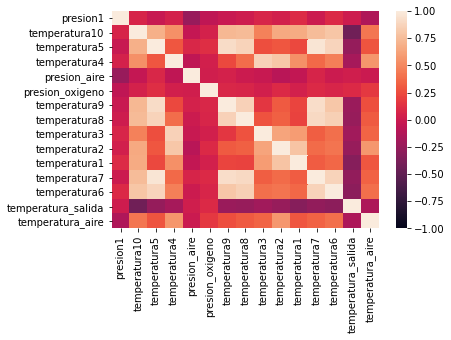

In [12]:
import seaborn as sns


corr = data['S1'].corr()
sns.heatmap(corr, xticklabels=corr.columns, yticklabels=corr.columns, vmin=-1, vmax=1);

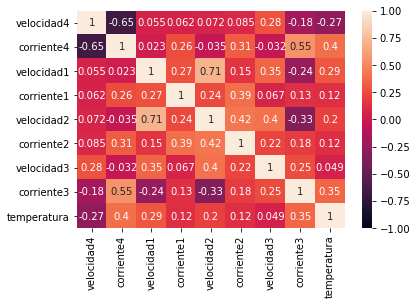

In [13]:
corr = data['S2'].corr()
sns.heatmap(corr, xticklabels=corr.columns, yticklabels=corr.columns, annot=True, vmin=-1, vmax=1);

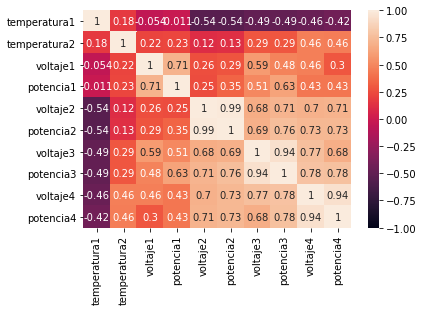

In [14]:
corr = data['S3'].corr()
sns.heatmap(corr, xticklabels=corr.columns, yticklabels=corr.columns, annot=True, vmin=-1, vmax=1);

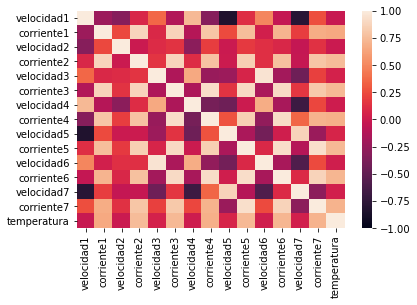

In [15]:
corr = data['S4'].corr()
sns.heatmap(corr, xticklabels=corr.columns, yticklabels=corr.columns, vmin=-1, vmax=1);

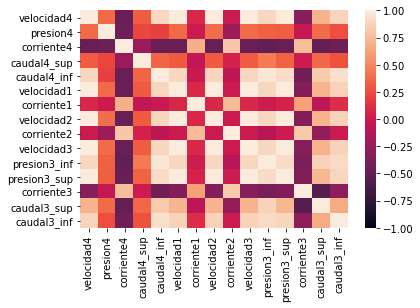

In [16]:
corr = data['S5'].corr()
sns.heatmap(corr, xticklabels=corr.columns, yticklabels=corr.columns, vmin=-1, vmax=1);

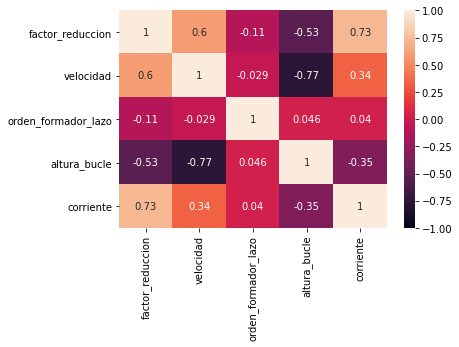

In [17]:
corr = data['S6a'].corr()
sns.heatmap(corr, xticklabels=corr.columns, yticklabels=corr.columns, annot=True, vmin=-1, vmax=1);

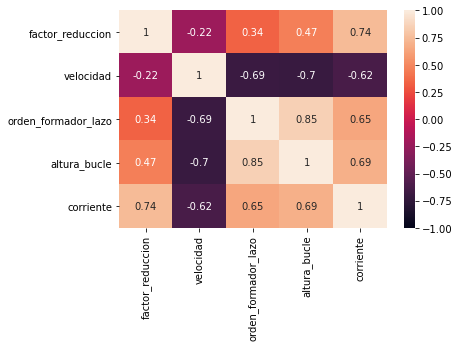

In [18]:
corr = data['S6b'].corr()
sns.heatmap(corr, xticklabels=corr.columns, yticklabels=corr.columns, annot=True, vmin=-1, vmax=1);

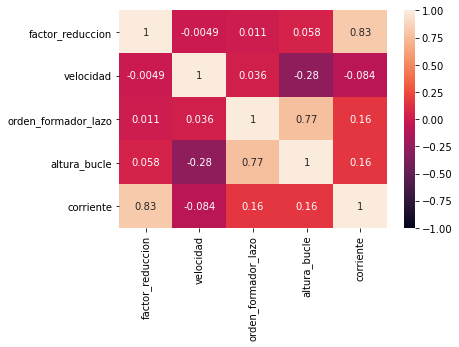

In [19]:
corr = data['S6c'].corr()
sns.heatmap(corr, xticklabels=corr.columns, yticklabels=corr.columns, annot=True, vmin=-1, vmax=1);

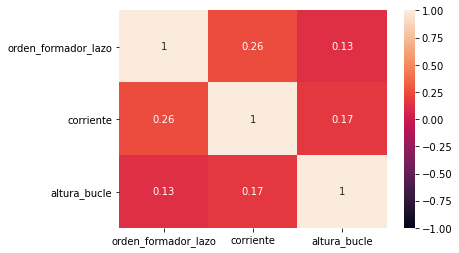

In [20]:
corr = data['S7a'].corr()
sns.heatmap(corr, xticklabels=corr.columns, yticklabels=corr.columns, annot=True, vmin=-1, vmax=1);

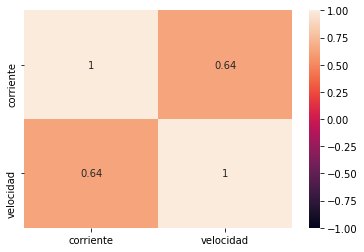

In [21]:
corr = data['S7b'].corr()
sns.heatmap(corr, xticklabels=corr.columns, yticklabels=corr.columns, annot=True, vmin=-1, vmax=1);

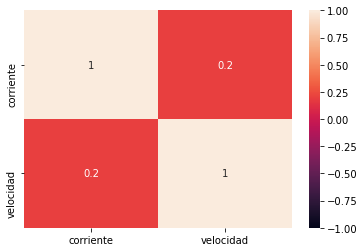

In [22]:
corr = data['S7c'].corr()
sns.heatmap(corr, xticklabels=corr.columns, yticklabels=corr.columns, annot=True, vmin=-1, vmax=1);

## 2.3  Visualización de los atributos y limpieza de datos

#### Histogramas antes de la limpieza de datos

Obtenemos los histogramas de los atributos para la sección uno para ver como se distribuyen los datos y detectar outliers a primera vista. 

In [23]:
seccion = 'S1'

fig = go.Figure()

columns = data[seccion].columns
false_array = np.zeros((len(columns)), dtype=bool)
visible_array = []

for idx in range(len(columns)):
    x_array = np.array(false_array)
    x_array[idx] = True
    visible_array.append(x_array)
    if idx == 0:
        fig.add_trace(go.Histogram(x=data[seccion].loc[:,columns[idx]],
                                   xbins=dict(start=np.min(data[seccion].loc[:,columns[idx]]),
                                              end=np.max(data[seccion].loc[:,columns[idx]]))))
    else:
        fig.add_trace(go.Histogram(x=data[seccion].loc[:,columns[idx]],
                                   xbins=dict(start=np.min(data[seccion].loc[:,columns[idx]]),
                                              end=np.max(data[seccion].loc[:,columns[idx]])),
                                   visible=False))
    
fig.update_layout(
    width=900,
    height=600,
    autosize=False,
    margin=dict(t=0, b=0, l=0, r=0),
    template="plotly_white",
)



buttons = [dict(args=[{"visible": visible_array[idx]}], label=columns[idx], method="update") for idx in range(len(columns))]

fig.update_layout(
    updatemenus=[
        dict(
            buttons=buttons,
            direction="down",
            pad={"r": 10, "t": 10},
            showactive=True,
            x=0.1,
            xanchor="left",
            y=1.1,
            yanchor="top"
        ),
    ]
)

### Limpieza de datos

In [24]:
data_analisis = dict(data)

for key in seccions:
    # Eliminamos los NaNs
    df = pd.DataFrame(data_analisis[key])
    df = df.dropna(axis=0)
    
    # Eliminamos las filas con más de la mitad de 0s en sus variables
    zeros = (df == 0).sum(axis=1) < (len(df.columns)/2)
    data_analisis[key] = df[zeros]
    
    # Calculamos cuantos outliers hay en el DF
    z_scores = zscore(df)
    abs_z_scores = np.abs(z_scores)
    filtered_entries = (abs_z_scores < 3).all(axis=1)
    data_analisis[key] = df[filtered_entries]

#### Histogramas después de la limpieza de datos
Definimos una función para poder mostrar los histogramas de cada sección. Se puede observar como por ejemplo, algunos de los histogramas de los  atributos de la sección **'S1'** varían bastante una vez se ha procedido a la limpieza de los datos.

In [25]:
def mostrar_histogramas(seccion):
    fig = go.Figure()

    columns = data_analisis[seccion].columns
    false_array = np.zeros((len(columns)), dtype=bool)
    visible_array = []

    for idx in range(len(columns)):
        x_array = np.array(false_array)
        x_array[idx] = True
        visible_array.append(x_array)
        if idx == 0:
            fig.add_trace(go.Histogram(x=data_analisis[seccion].loc[:,columns[idx]],
                                       xbins=dict(start=np.min(data_analisis[seccion].loc[:,columns[idx]]),
                                                  end=np.max(data_analisis[seccion].loc[:,columns[idx]]))))
        else:
            fig.add_trace(go.Histogram(x=data_analisis[seccion].loc[:,columns[idx]],
                                       xbins=dict(start=np.min(data_analisis[seccion].loc[:,columns[idx]]),
                                                  end=np.max(data_analisis[seccion].loc[:,columns[idx]])),
                                       visible=False))

    fig.update_layout(
        width=900,
        height=600,
        autosize=False,
        margin=dict(t=0, b=0, l=0, r=0),
        template="plotly_white",
    )



    buttons = [dict(args=[{"visible": visible_array[idx]}], label=columns[idx], method="update") for idx in range(len(columns))]

    fig.update_layout(
        updatemenus=[
            dict(
                buttons=buttons,
                direction="down",
                pad={"r": 10, "t": 10},
                showactive=True,
                x=0.1,
                xanchor="left",
                y=1.1,
                yanchor="top"
            ),
        ]
    )
    fig.show()

In [26]:
mostrar_histogramas('S1')

In [27]:
mostrar_histogramas('S2')

In [28]:
mostrar_histogramas('S3')

In [29]:
mostrar_histogramas('S4')

In [30]:
mostrar_histogramas('S5')

In [31]:
mostrar_histogramas('S6a')

In [32]:
mostrar_histogramas('S6b')

In [33]:
mostrar_histogramas('S6c')

In [34]:
mostrar_histogramas('S7a')

In [35]:
mostrar_histogramas('S7b')

In [36]:
mostrar_histogramas('S7c')

In [37]:
def save_pickle(data, file_name):
    with open(file_name + '.pickle', 'wb') as f:
        pickle.dump(data, f)

# 3. Normalización de datos y reducción de dimensionalidad

## 3.1 Normalización de los datos
Usamos StandardScaler para obtener el factor por el que hay que multiplicar cada columna para estandarizar los datos, seguidamente guardamos los factores de transformación.

In [38]:
scalers = dict()

for key in seccions:
    scaler = StandardScaler()
    scalers[key] = scaler.fit(data_analisis[key])
    data_analisis[key] = scaler.transform(data_analisis[key])

save_pickle(scalers, 'data/scalers')
data_analisis

{'general':       weight id_colada   lenght        material        id_barra  calidad  \
 0     2652.0  GS134970  17679.0  WAK7508055N000  200109_1457370     K75G   
 1     2635.0  GS134970  17661.0  WAK7508055N000  200109_1502590     K75G   
 2     2646.0  GS134970  17714.0  WAK7508055N000  200109_1504000     K75G   
 3     2643.0  GS134970  17740.0  WAK7508055N000  200109_1505010     K75G   
 4     2649.0  GS134970  17608.0  WAK7508055N000  200109_1506010     K75G   
 ...      ...       ...      ...             ...             ...      ...   
 4473  3040.0  GS138015  20321.0  WAK55B1055L000  200719_2033180  K55M-BS   
 4474  3041.0  GS138015  20282.0  WAK55B1055L000  200719_2035590  K55M-BS   
 4475  3023.0  GS138015  20383.0  WAK55B1055L000  200719_2034380  K55M-BS   
 4476  3035.0  GS138015  20282.0  WAK55B1055L000  200719_2038370  K55M-BS   
 4477  3050.0  GS138015  20383.0  WAK55B1055L000  200719_2037170  K55M-BS   
 
       diametro  timestamp_millis  tipo_fallo     timestamp_bar

## 3.2 Principal Components Analysis

### Varianza explicada de la PCA

Primero vemos cuanta de la varianza explica cada valor propio asociado a la PCA para decidir el número de componentes con las que nos queremos quedar, dado que las secciones **'S7a', 'S7b' y 'S7c'** tienen 4 variables o menos y se ha de cumplir que `n_components < min(n_samples, n_features)` sólo calculamos la ratio de varianza explicada para las otras secciones.

In [39]:
varianza_acumulada = dict()
for key in seccions[:8]:
    pca = PCA(n_components=5)
    pca.fit_transform(data_analisis[key])
    ratio_varianza_explicada = pca.explained_variance_ratio_.round(3)
    var_exp = ratio_varianza_explicada.tolist()
    var_exp = [i*100 for i in var_exp]
    var_acum = np.cumsum(var_exp)
    varianza_acumulada[key] = var_acum

varianza_acumulada

{'S1': array([43.3, 59.7, 68.5, 76.8, 83.1]),
 'S2': array([29.2, 52. , 66.9, 77.5, 86.2]),
 'S3': array([61.3, 72.9, 82.7, 88.7, 93.1]),
 'S4': array([34.7, 62.3, 75.2, 84. , 90.1]),
 'S5': array([43.1, 63.8, 82.3, 90.7, 95.6]),
 'S6a': array([ 53.5,  73.8,  91.4,  96.5, 100. ]),
 'S6b': array([68.8, 87.4, 94.5, 97.7, 99.9]),
 'S6c': array([38.8, 68. , 88.4, 96.9, 99.9])}

Vemos que en todos los casos con sólo 2 componentes se explica como mínimo más del 50 % de la varianza y que las otras componentes no añaden demasiada información, por tanto procedemos a usar 2 componentes para la PCA de cada sección.

### Obtención y visualización de la PCA por secciones

In [40]:
pcas = dict()

for key in seccions:
    pca = PCA(n_components=2)
    pcas[key] = pca.fit_transform(data_analisis[key])

save_pickle(scalers, 'data/scalers')
pcas

{'S1': array([[ 3.40292121, -2.29233447],
        [ 3.31457243, -2.06396697],
        [ 3.19474788, -1.82470421],
        ...,
        [ 0.65561508, -1.43165072],
        [ 0.50033251, -1.49348665],
        [ 0.86585271, -1.16569721]]),
 'S2': array([[ 2.65700875,  0.71161898],
        [ 3.27893606,  1.42708014],
        [ 2.18805661,  0.85236634],
        ...,
        [ 0.26219951,  0.30677163],
        [-0.66143578, -0.94680962],
        [-0.01395988,  0.07114655]]),
 'S3': array([[ 8.47510248,  0.21326547],
        [ 7.98520625,  0.03441291],
        [ 7.46592571,  0.12457504],
        ...,
        [ 1.37737484, -0.21508904],
        [ 1.03319938, -0.25864502],
        [ 0.98728452, -0.56421232]]),
 'S4': array([[ 0.76729022, 11.4033065 ],
        [-3.32546889,  8.11819508],
        [-3.09537198,  8.31933964],
        ...,
        [ 6.57608072,  2.37176799],
        [ 2.57879609, -1.81304981],
        [ 2.7151265 , -1.66956833]]),
 'S5': array([[ 3.46696846,  3.47139235],
        [ 

In [41]:
def pca_plot(seccion):
    plt.figure()
    plt.scatter(pcas[seccion][:,0], pcas[seccion][:,1],alpha=0.5)
    plt.title('PCA Train Data')
    plt.show();

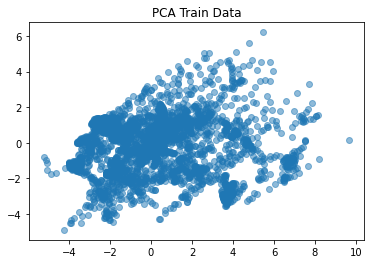

In [42]:
pca_plot('S1')

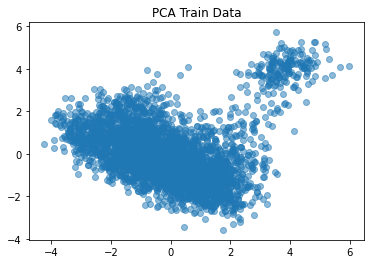

In [43]:
pca_plot('S2')

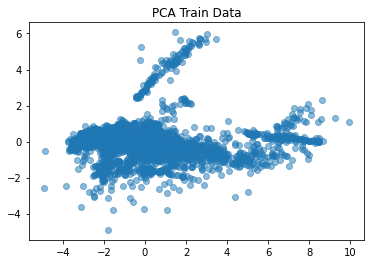

In [44]:
pca_plot('S3')

En la sección 4 se observa como la PCA es muy dispersa, esto se debe a que muchas de las variables se distrubuyen de forma no unimodal. En casos como este la PCA no será tan buena herramienta como en casos como por ejemplo la sección **S1**.

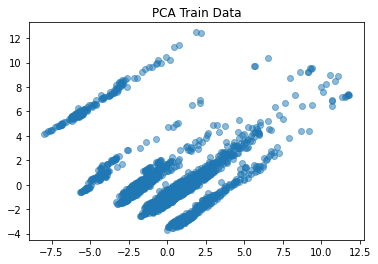

In [45]:
pca_plot('S4')

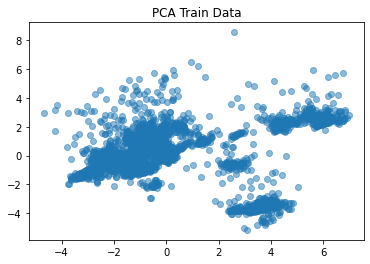

In [46]:
pca_plot('S5')

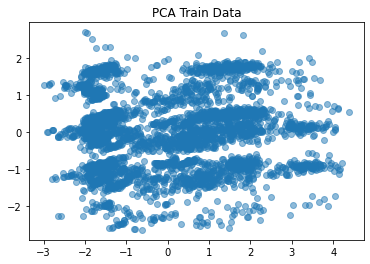

In [47]:
pca_plot('S6a')

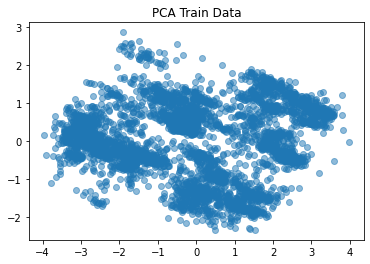

In [48]:
pca_plot('S6b')

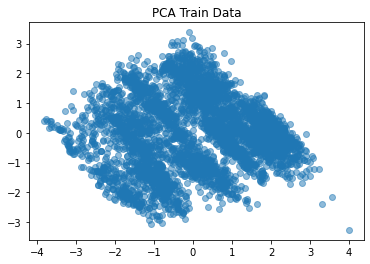

In [49]:
pca_plot('S6c')

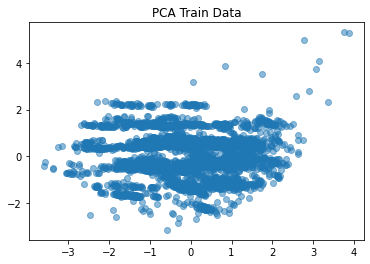

In [50]:
pca_plot('S7a')

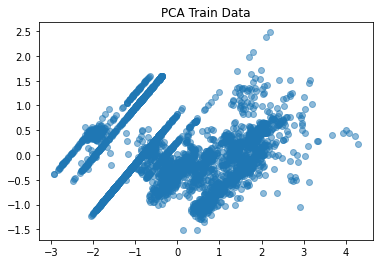

In [51]:
pca_plot('S7b')

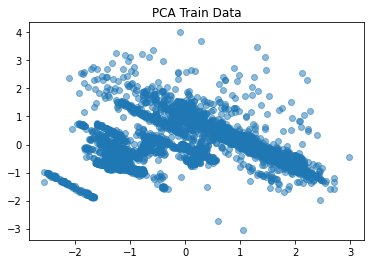

In [52]:
pca_plot('S7c')

# 4. Detección de anomalías y novedades

Usamos un OC-SVM para detectar anomalías y novedades, obtenemos la frontera de novedades y la frontera de anomalías:
* El parámetro `nu` representa la proporción de outliers que esperamos observar
* El parámetro `gamma` determina la influencia de los puntos más alejados en las fronteras de decisión. Un valor bajo significa que los valores lejanos se tienen más en consideración a la hora de elegir las fronteras de decisión.

In [53]:
models = dict()
def one_class(seccion, nu, gamma, threshold, threshold2):
    model=svm.OneClassSVM(nu=nu, kernel="rbf", gamma=gamma)
    model.fit(pcas[seccion])
    models[seccion] = model
    y = model.decision_function(pcas[seccion])
    normalidad = np.zeros(len(y))
    normalidad[y >= threshold2] = 1
    normalidad[y >= threshold] = 2
    
    pnormal = (normalidad[normalidad == 2].size/normalidad.size)*100
    pdesviacion = (normalidad[normalidad == 1].size/normalidad.size)*100
    panomalo = (normalidad[normalidad == 0].size/normalidad.size)*100
    
    pca = pcas[seccion]
    
    x_min = pca[:,0].min() - pca[:,0].max()*0.3
    x_max = pca[:,0].max() + pca[:,0].max()*0.3
    y_min = pca[:,1].min() - pca[:,1].max()*0.3
    y_max = pca[:,1].max() + pca[:,1].max()*0.3
    h = .05  # step size in the mesh
    # Plot del modelo con los datos entrenamiento
    xx, yy = np.meshgrid(np.arange(x_min, x_max, h),np.arange(y_min, y_max, h))
    Z = model.decision_function(np.c_[xx.ravel(), yy.ravel()])
    Z = Z.reshape(xx.shape)
    g = plt.figure(figsize=[12.8, 9.6])
    plt.title("Novelty Detection")
    plt.contourf(xx, yy, Z, levels=np.linspace(Z.min(), 0, 7), cmap=plt.cm.PuBu)
    a = plt.contour(xx, yy, Z, levels=[threshold], linewidths=2 , colors='darkred')
    aa = plt.contour(xx, yy, Z, levels=[threshold2], linewidths=2, linestyles='dotted' , colors='darkred')
    plt.contourf(xx, yy, Z, levels=[0, Z.max()], colors='palevioletred')
    s = 30
    b1 = plt.scatter(pca[:,0][normalidad == 0], pca[:,1][normalidad == 0], c='tomato', s=s, edgecolors='k',alpha=0.5)
    b1 = plt.scatter(pca[:,0][normalidad == 1], pca[:,1][normalidad == 1], c='khaki', s=s, edgecolors='k',alpha=0.5)
    b1 = plt.scatter(pca[:,0][normalidad == 2], pca[:,1][normalidad == 2], c='lightgreen', s=s, edgecolors='k',alpha=0.5)
    plt.axis('tight')
    plt.xlim((x_min, x_max))
    plt.ylim((y_min, y_max))
    plt.legend([a.collections[0],aa.collections[0], b1],
               ["Frontera de novedad", "Frontera de anomalias","training observations",
                "new regular observations"],
               loc="upper left",
               prop=matplotlib.font_manager.FontProperties(size=11))

    plt.xlabel(
        "Normalidad: %0.1f; Desviación: %0.1f; Anomalia: %0.1f" % (pnormal, pdesviacion, panomalo))
    g.show()

* Otro posible algoritmo a utilizar, entre otros, es el del EllipticEnvelope. No obstante este asume que los datos se distribuyen de forma Gaussiana y por tanto, cuando los datos no son unimodales no funciona tan bien. Esto se puede ver a modo ejemplo en la sección **'S4'**.

In [54]:
from sklearn.covariance import EllipticEnvelope
models = dict()
def elliptic(seccion, contamination, threshold, threshold2):
    model=EllipticEnvelope(contamination=contamination)
    model.fit(pcas[seccion])
    y = model.decision_function(pcas[seccion])
    normalidad = np.zeros(len(y))
    normalidad[y >= threshold2] = 1
    normalidad[y >= threshold] = 2
    
    pnormal = (normalidad[normalidad == 2].size/normalidad.size)*100
    pdesviacion = (normalidad[normalidad == 1].size/normalidad.size)*100
    panomalo = (normalidad[normalidad == 0].size/normalidad.size)*100
    
    pca = pcas[seccion]
    
    x_min = pca[:,0].min() - pca[:,0].max()*0.3
    x_max = pca[:,0].max() + pca[:,0].max()*0.3
    y_min = pca[:,1].min() - pca[:,1].max()*0.3
    y_max = pca[:,1].max() + pca[:,1].max()*0.3
    h = .05  # step size in the mesh
    # Plot del modelo con los datos entrenamiento
    xx, yy = np.meshgrid(np.arange(x_min, x_max, h),np.arange(y_min, y_max, h))
    Z = model.decision_function(np.c_[xx.ravel(), yy.ravel()])
    Z = Z.reshape(xx.shape)
    g = plt.figure(figsize=[12.8, 9.6])
    plt.title("Novelty Detection")
    plt.contourf(xx, yy, Z, levels=np.linspace(Z.min(), 0, 7), cmap=plt.cm.PuBu)
    a = plt.contour(xx, yy, Z, levels=[threshold], linewidths=2 , colors='darkred')
    aa = plt.contour(xx, yy, Z, levels=[threshold2], linewidths=2, linestyles='dotted' , colors='darkred')
    plt.contourf(xx, yy, Z, levels=[0, Z.max()], colors='palevioletred')
    s = 30
    b1 = plt.scatter(pca[:,0][normalidad == 0], pca[:,1][normalidad == 0], c='tomato', s=s, edgecolors='k',alpha=0.5)
    b1 = plt.scatter(pca[:,0][normalidad == 1], pca[:,1][normalidad == 1], c='khaki', s=s, edgecolors='k',alpha=0.5)
    b1 = plt.scatter(pca[:,0][normalidad == 2], pca[:,1][normalidad == 2], c='lightgreen', s=s, edgecolors='k',alpha=0.5)
    plt.axis('tight')
    plt.xlim((x_min, x_max))
    plt.ylim((y_min, y_max))
    plt.legend([a.collections[0],aa.collections[0], b1],
               ["Frontera de novedad", "Frontera de anomalias","training observations",
                "new regular observations"],
               loc="upper left",
               prop=matplotlib.font_manager.FontProperties(size=11))

    plt.xlabel(
        "Normalidad: %0.1f; Desviación: %0.1f; Anomalia: %0.1f" % (pnormal, pdesviacion, panomalo))
    g.show()

C:\Users\Albert Yanguas\Anaconda3\lib\site-packages\ipykernel_launcher.py:47: UserWarning:

Matplotlib is currently using module://ipykernel.pylab.backend_inline, which is a non-GUI backend, so cannot show the figure.



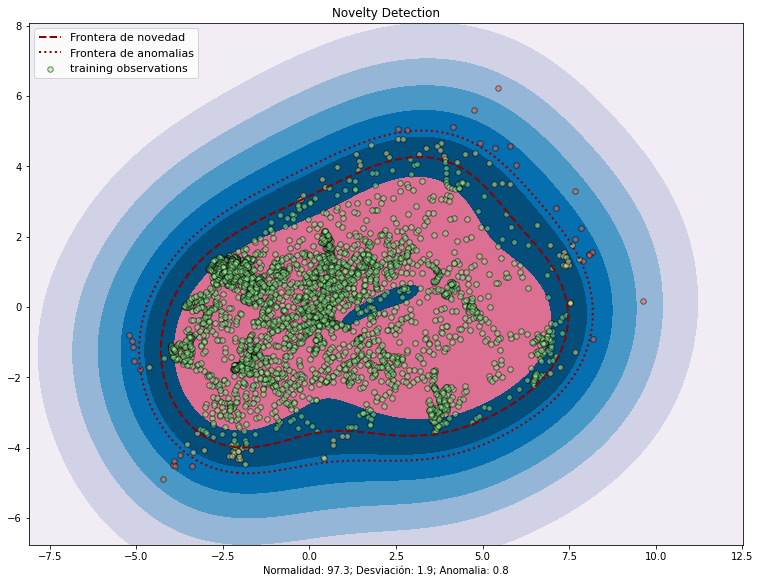

In [55]:
one_class('S1', 0.1, 0.1, -5, -15)

* Como se puede observar en el siguiente gráfico, si a la misma sección **S1** le introducimos un valor de `gamma` mayor esta pierde la forma de elipsis, puesto que los puntos más lejanos dejan de tener tanta importancia.

C:\Users\Albert Yanguas\Anaconda3\lib\site-packages\ipykernel_launcher.py:30: UserWarning:

No contour levels were found within the data range.

C:\Users\Albert Yanguas\Anaconda3\lib\site-packages\ipykernel_launcher.py:47: UserWarning:

Matplotlib is currently using module://ipykernel.pylab.backend_inline, which is a non-GUI backend, so cannot show the figure.



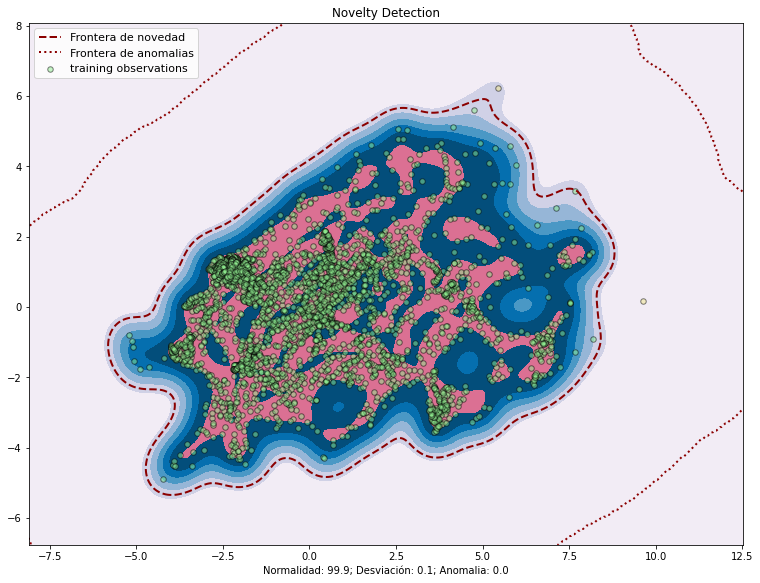

In [56]:
one_class('S1', 0.1, 2, -5, -15)

C:\Users\Albert Yanguas\Anaconda3\lib\site-packages\ipykernel_launcher.py:47: UserWarning:

Matplotlib is currently using module://ipykernel.pylab.backend_inline, which is a non-GUI backend, so cannot show the figure.



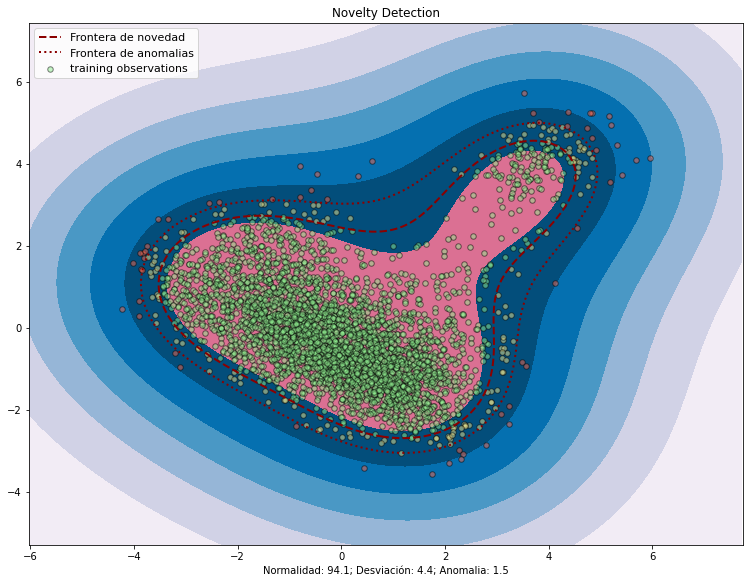

In [57]:
one_class('S2', 0.1, 0.1, -3, -10)

C:\Users\Albert Yanguas\Anaconda3\lib\site-packages\ipykernel_launcher.py:47: UserWarning:

Matplotlib is currently using module://ipykernel.pylab.backend_inline, which is a non-GUI backend, so cannot show the figure.



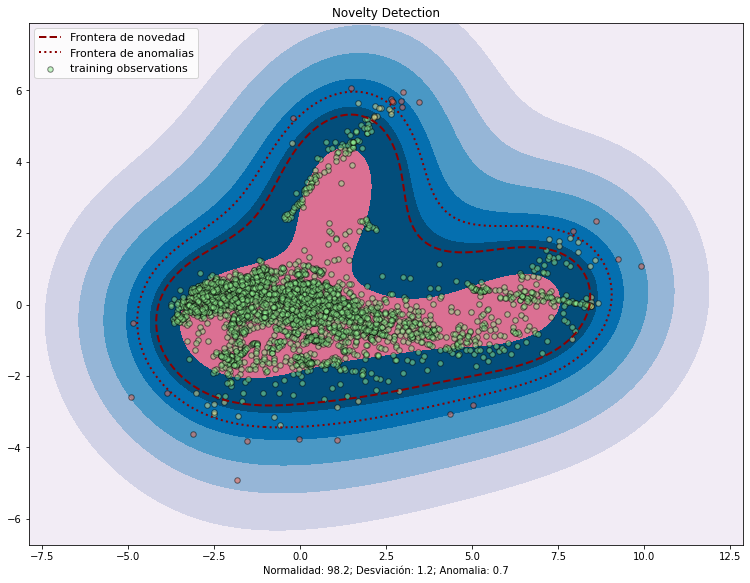

In [58]:
one_class('S3', 0.1, 0.1, -10, -20)

C:\Users\Albert Yanguas\Anaconda3\lib\site-packages\ipykernel_launcher.py:47: UserWarning:

Matplotlib is currently using module://ipykernel.pylab.backend_inline, which is a non-GUI backend, so cannot show the figure.



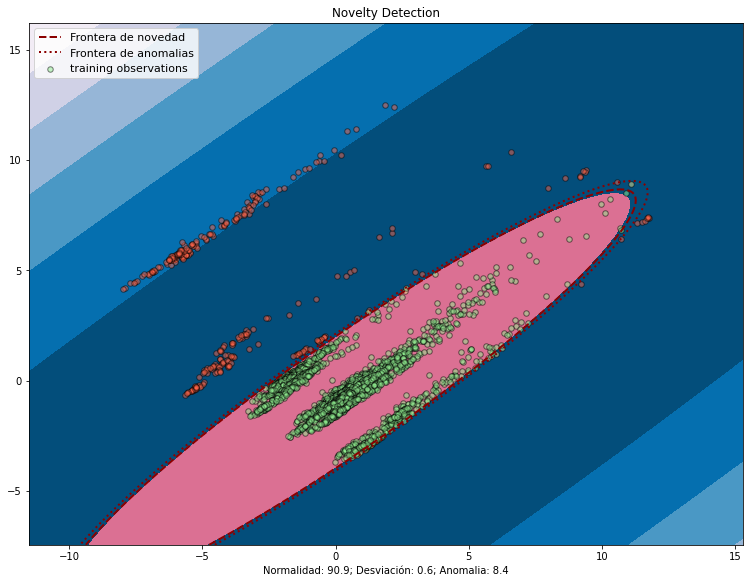

In [59]:
# La misma sección usando EllipticEnvelope detecta muchas más anomalías
elliptic('S4', 0.1, -5, -15)

C:\Users\Albert Yanguas\Anaconda3\lib\site-packages\ipykernel_launcher.py:47: UserWarning:

Matplotlib is currently using module://ipykernel.pylab.backend_inline, which is a non-GUI backend, so cannot show the figure.



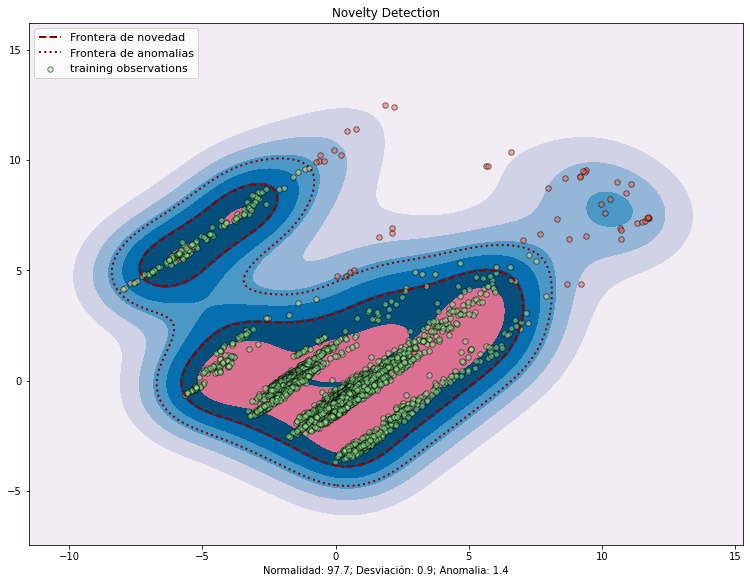

In [60]:
one_class('S4', 0.1, 0.2, -5, -15)

C:\Users\Albert Yanguas\Anaconda3\lib\site-packages\ipykernel_launcher.py:47: UserWarning:

Matplotlib is currently using module://ipykernel.pylab.backend_inline, which is a non-GUI backend, so cannot show the figure.



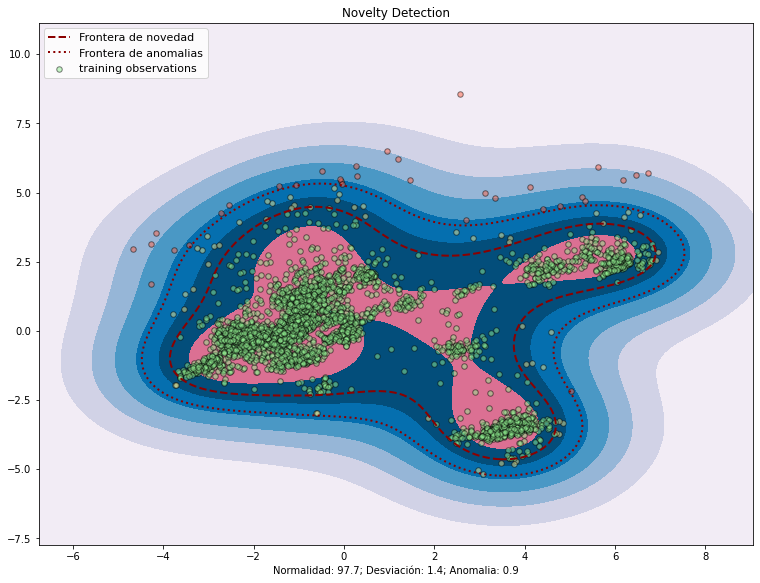

In [61]:
one_class('S5', 0.1, 0.2, -5, -15)

C:\Users\Albert Yanguas\Anaconda3\lib\site-packages\ipykernel_launcher.py:47: UserWarning:

Matplotlib is currently using module://ipykernel.pylab.backend_inline, which is a non-GUI backend, so cannot show the figure.



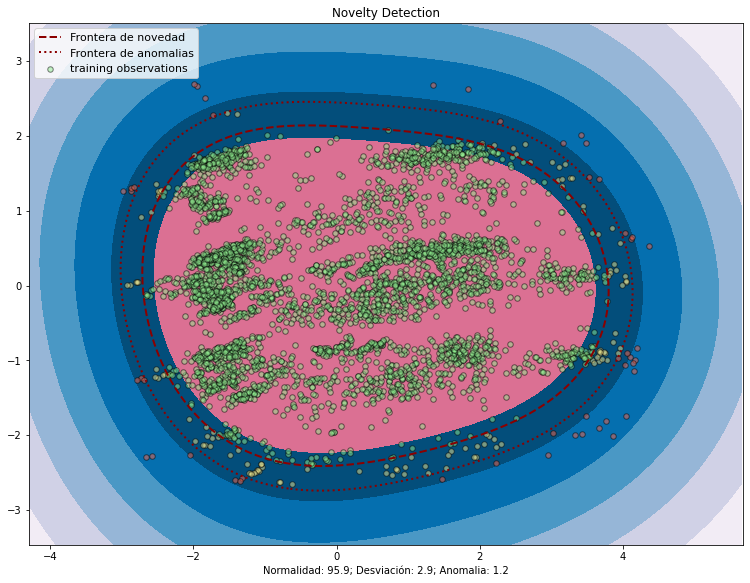

In [62]:
one_class('S6a', 0.1, 0.1, -5, -15)

C:\Users\Albert Yanguas\Anaconda3\lib\site-packages\ipykernel_launcher.py:47: UserWarning:

Matplotlib is currently using module://ipykernel.pylab.backend_inline, which is a non-GUI backend, so cannot show the figure.



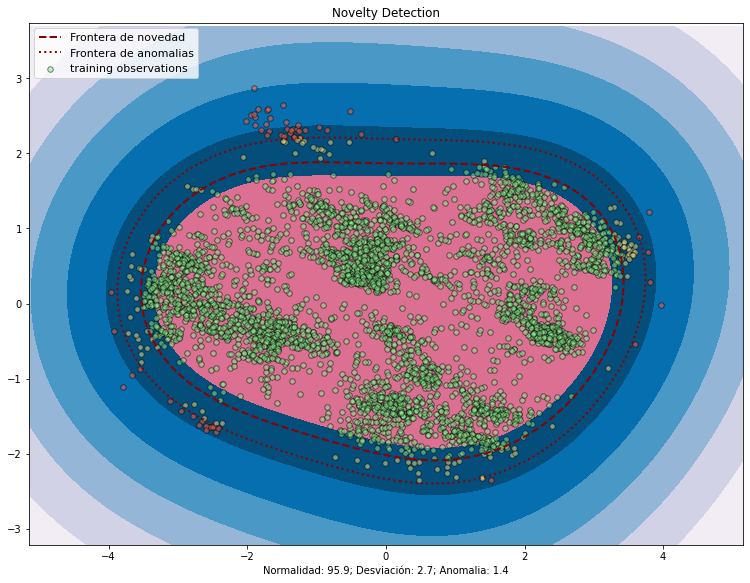

In [63]:
one_class('S6b', 0.1, 0.1, -5, -15)

C:\Users\Albert Yanguas\Anaconda3\lib\site-packages\ipykernel_launcher.py:47: UserWarning:

Matplotlib is currently using module://ipykernel.pylab.backend_inline, which is a non-GUI backend, so cannot show the figure.



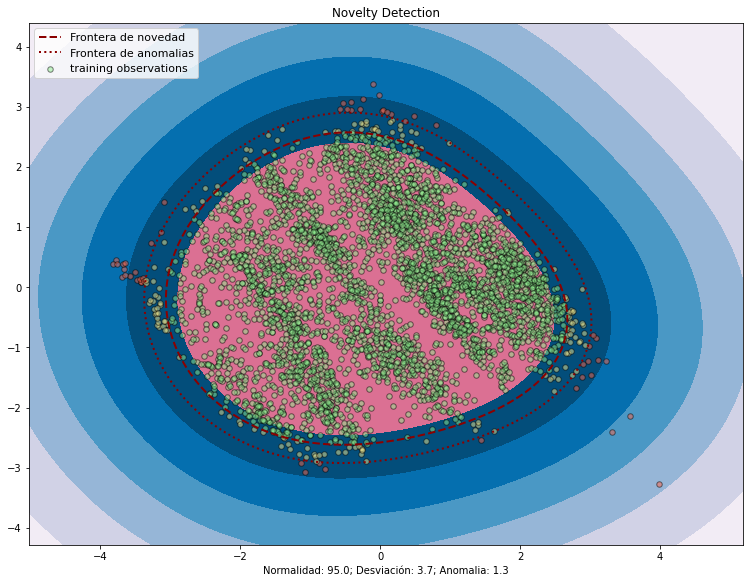

In [64]:
one_class('S6c', 0.1, 0.1, -5, -15)

C:\Users\Albert Yanguas\Anaconda3\lib\site-packages\ipykernel_launcher.py:47: UserWarning:

Matplotlib is currently using module://ipykernel.pylab.backend_inline, which is a non-GUI backend, so cannot show the figure.



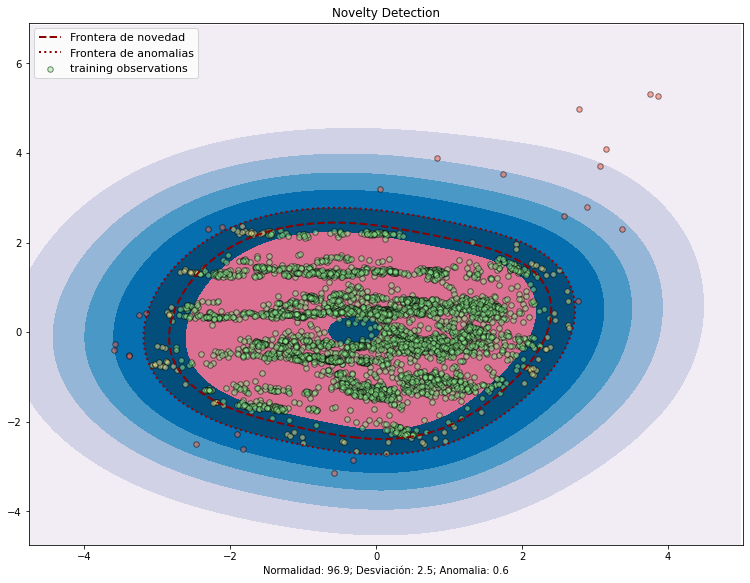

In [65]:
one_class('S7a', 0.1, 0.3, -5, -15)

C:\Users\Albert Yanguas\Anaconda3\lib\site-packages\ipykernel_launcher.py:47: UserWarning:

Matplotlib is currently using module://ipykernel.pylab.backend_inline, which is a non-GUI backend, so cannot show the figure.



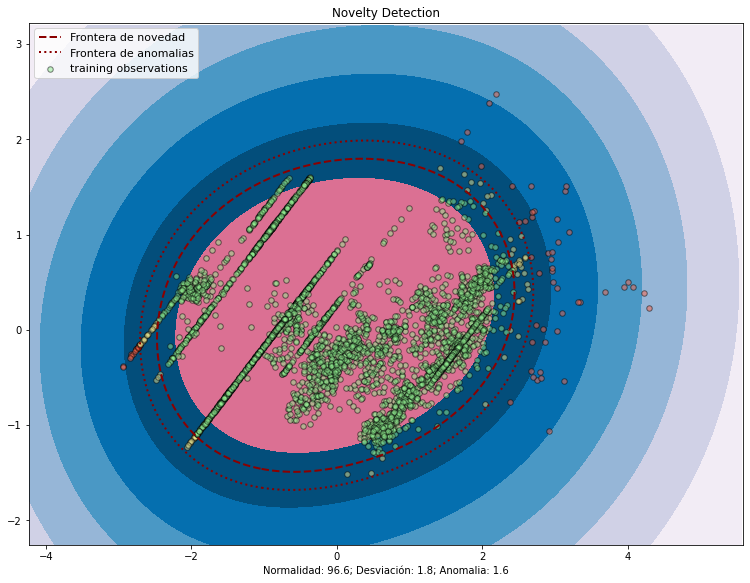

In [66]:
one_class('S7b', 0.1, 0.1, -10, -20)

C:\Users\Albert Yanguas\Anaconda3\lib\site-packages\ipykernel_launcher.py:47: UserWarning:

Matplotlib is currently using module://ipykernel.pylab.backend_inline, which is a non-GUI backend, so cannot show the figure.



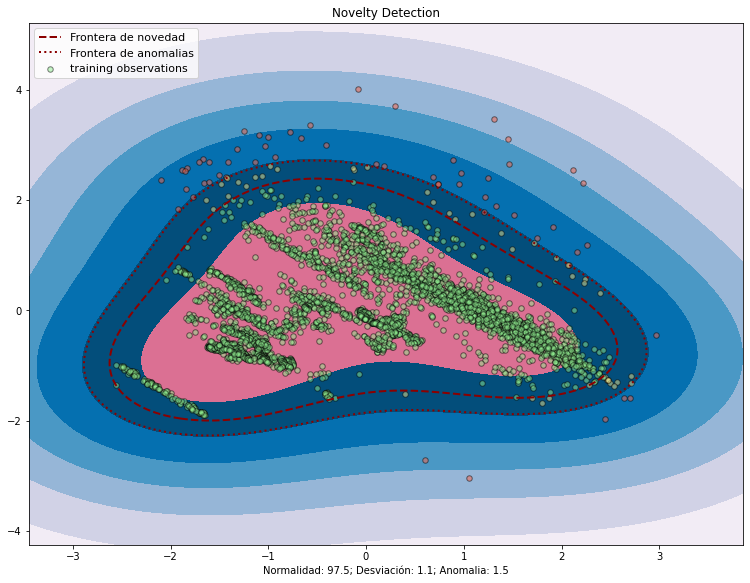

In [67]:
one_class('S7c', 0.1, 0.2, -10, -20)

In [68]:
save_pickle(models, 'data/models')